In [1]:
import numpy as np
from scipy.signal import find_peaks
from scipy.optimize import curve_fit
import matplotlib.pyplot as plt
import os
import tkinter as tk
from tkinter import messagebox
import pandas as pd

In [ ]:
df = pd.read_csv('C:/Users/SPHERES/Downloads/hBN-map4.csv')

df = df.dropna(how='all')

df = df[~df.apply(lambda row: row.astype(str).str.contains(r'^Frame \d+', regex=True).any(), axis=1)]

#df.to_excel('cleaned_file.xlsx', index=False)

df

,Frame 1
0,1158.612\t1861
1,1158.980\t605
2,1159.348\t604
3,1159.716\t605
4,1160.086\t604
...,...
484095,1630.722\t693
484096,1631.062\t680
484097,1631.401\t692
484098,1631.741\t690


In [ ]:
df[['Wavenumber', 'Intensity']] = df['Frame 1'].str.split('\t', expand=True)

df

,Frame 1,Wavenumber,Intensity
0,1158.612\t1861,1158.612,1861
1,1158.980\t605,1158.980,605
2,1159.348\t604,1159.348,604
3,1159.716\t605,1159.716,605
4,1160.086\t604,1160.086,604
...,...,...,...
484095,1630.722\t693,1630.722,693
484096,1631.062\t680,1631.062,680
484097,1631.401\t692,1631.401,692
484098,1631.741\t690,1631.741,690


In [4]:
df[['Wavenumber', 'Intensity']] = df[['Wavenumber', 'Intensity']].apply(pd.to_numeric, errors='coerce')

In [5]:
len(df)

483740

In [ ]:
df_subset = df.head(1340) 

#df_subset_2 = df[1341:2680]

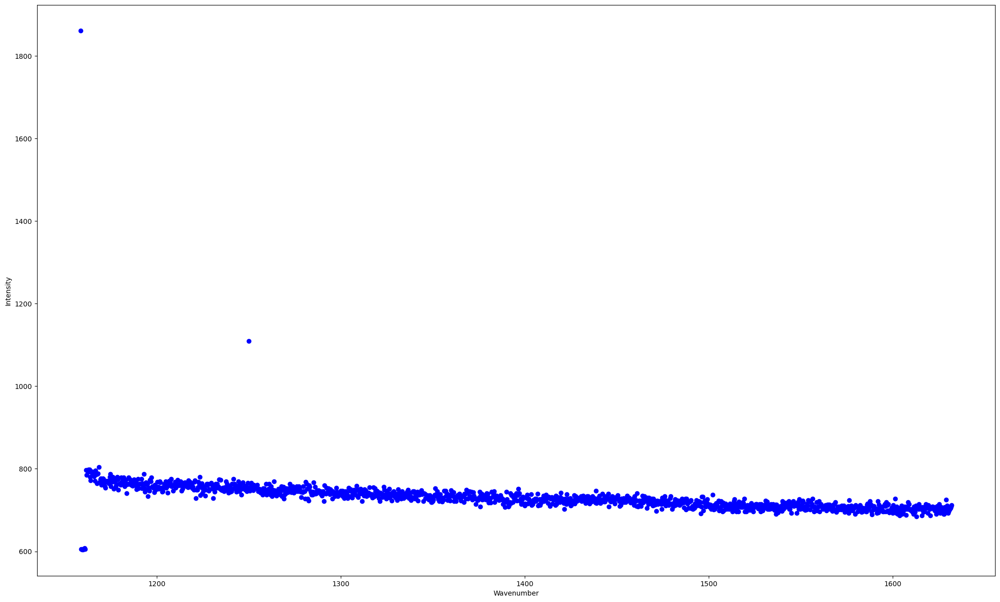

In [ ]:
plt.figure(figsize=(25, 15))
plt.scatter(df_subset['Wavenumber'], df_subset['Intensity'], color='blue', label='Frame 1')
plt.xlabel('Wavenumber')
plt.ylabel('Intensity')

plt.show()

# Gaussian Fitting

A is the amplitude
<br>
μ is the mean (center of the peak)
<br>
σ is the standard deviation (width of the peak)

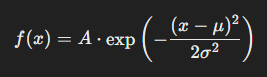

# Lorentzian Fitting

A is the amplitude
<br>
μ is the center of the peak
<br>
γ is the half-width at half maximum (HWHM)

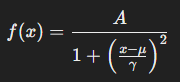

In [ ]:
from scipy.optimize import curve_fit

def gaussian(x, A, mu, sigma):
    return A * np.exp(-(x - mu)**2 / (2 * sigma**2))

def lorentzian(x, A, mu, gamma):
    return A / (1 + ((x - mu) / gamma)**2)

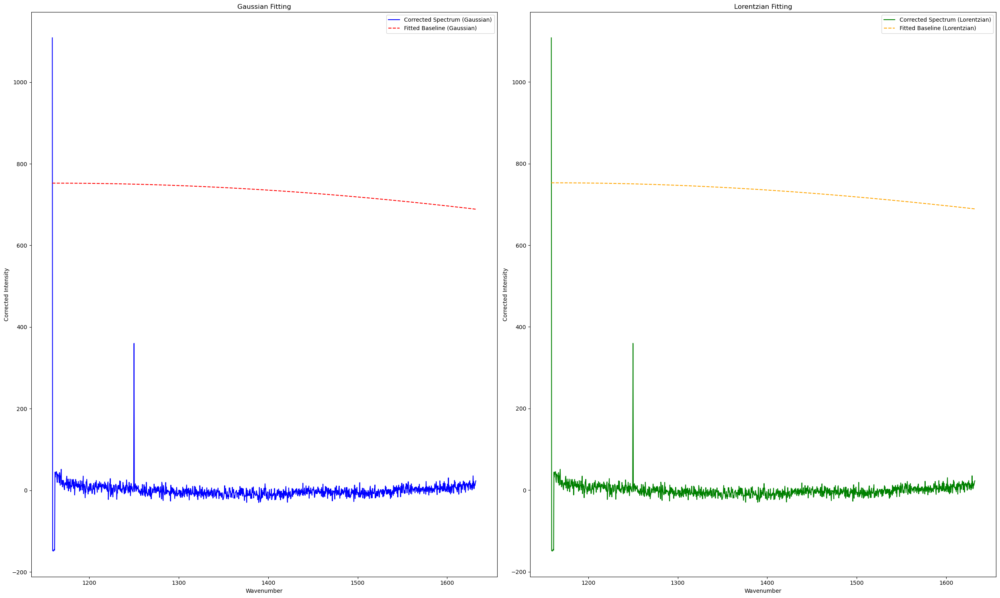

In [ ]:
df_subset = df_subset.copy()

p0_gaussian = [np.max(df_subset['Intensity']), np.mean(df_subset['Wavenumber']), 1]
p0_lorentzian = [np.max(df_subset['Intensity']), np.mean(df_subset['Wavenumber']), 1]

bounds = ([0, min(df_subset['Wavenumber']), 0], [np.inf, max(df_subset['Wavenumber']), np.inf])

params_gaussian, _ = curve_fit(gaussian, df_subset['Wavenumber'], df_subset['Intensity'], p0=p0_gaussian, bounds=bounds, maxfev=10000)

params_lorentzian, _ = curve_fit(lorentzian, df_subset['Wavenumber'], df_subset['Intensity'], p0=p0_lorentzian, bounds=bounds, maxfev=10000)

fitted_baseline_gaussian = gaussian(df_subset['Wavenumber'], *params_gaussian)
fitted_baseline_lorentzian = lorentzian(df_subset['Wavenumber'], *params_lorentzian)

df_subset.loc[:, 'Corrected_Intensity_Gaussian'] = df_subset['Intensity'] - fitted_baseline_gaussian
df_subset.loc[:, 'Corrected_Intensity_Lorentzian'] = df_subset['Intensity'] - fitted_baseline_lorentzian

fig, axes = plt.subplots(1, 2, figsize=(25, 15))

axes[0].plot(df_subset['Wavenumber'], df_subset['Corrected_Intensity_Gaussian'], color='blue', label='Corrected Spectrum (Gaussian)')
axes[0].plot(df_subset['Wavenumber'], fitted_baseline_gaussian, color='red', linestyle='--', label='Fitted Baseline (Gaussian)')
axes[0].set_xlabel('Wavenumber')
axes[0].set_ylabel('Corrected Intensity')
axes[0].legend()
axes[0].set_title('Gaussian Fitting')

axes[1].plot(df_subset['Wavenumber'], df_subset['Corrected_Intensity_Lorentzian'], color='green', label='Corrected Spectrum (Lorentzian)')
axes[1].plot(df_subset['Wavenumber'], fitted_baseline_lorentzian, color='orange', linestyle='--', label='Fitted Baseline (Lorentzian)')
axes[1].set_xlabel('Wavenumber')
axes[1].set_ylabel('Corrected Intensity')
axes[1].legend()
axes[1].set_title('Lorentzian Fitting')

plt.tight_layout()
plt.show()

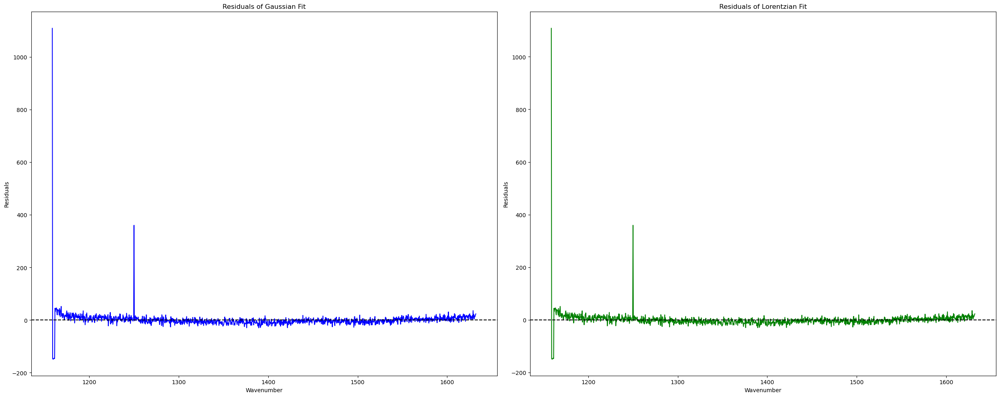

In [ ]:
residual_gaussian = df_subset['Intensity'] - fitted_baseline_gaussian
residual_lorentzian = df_subset['Intensity'] - fitted_baseline_lorentzian

plt.figure(figsize=(25, 10))

plt.subplot(1, 2, 1)
plt.plot(df_subset['Wavenumber'], residual_gaussian, color='blue')
plt.axhline(0, color='black', linestyle='--')
plt.title("Residuals of Gaussian Fit")
plt.xlabel("Wavenumber")
plt.ylabel("Residuals")

plt.subplot(1, 2, 2)
plt.plot(df_subset['Wavenumber'], residual_lorentzian, color='green')
plt.axhline(0, color='black', linestyle='--')
plt.title("Residuals of Lorentzian Fit")
plt.xlabel("Wavenumber")
plt.ylabel("Residuals")

plt.tight_layout()
plt.show()


# Feature Extraction
<br>
Maximum Intensity: The peak intensity in the corrected spectrum.
<br>
Maximum Position (Peak Position): The wavenumber at which the peak occurs.
<br>
Area Under the Curve (AUC): The total area under the corrected spectrum.
<br>
Full Width at Half Maximum (FWHM): The width of the peak at half the maximum intensity.

In [ ]:
from scipy.integrate import trapz

def calculate_fwhm(wavenumbers, intensities):
    half_max = np.max(intensities) / 2

    above_half_max = np.where(intensities >= half_max)[0]

    # The FWHM is the difference between the largest and smallest wavenumbers where intensity >= half_max
    if len(above_half_max) > 1:
        fwhm = wavenumbers[above_half_max[-1]] - wavenumbers[above_half_max[0]]
    else:
        fwhm = 0
    
    return fwhm

max_intensity_gaussian = np.max(df_subset['Corrected_Intensity_Gaussian'])
max_position_gaussian = df_subset['Wavenumber'][df_subset['Corrected_Intensity_Gaussian'].idxmax()]
area_gaussian = trapz(df_subset['Corrected_Intensity_Gaussian'], df_subset['Wavenumber'])
fwhm_gaussian = calculate_fwhm(df_subset['Wavenumber'], df_subset['Corrected_Intensity_Gaussian'])

max_intensity_lorentzian = np.max(df_subset['Corrected_Intensity_Lorentzian'])
max_position_lorentzian = df_subset['Wavenumber'][df_subset['Corrected_Intensity_Lorentzian'].idxmax()]
area_lorentzian = trapz(df_subset['Corrected_Intensity_Lorentzian'], df_subset['Wavenumber'])
fwhm_lorentzian = calculate_fwhm(df_subset['Wavenumber'], df_subset['Corrected_Intensity_Lorentzian'])

results = {
    'Feature': ['Maximum Intensity', 'Maximum Position (Wavenumber)', 'Area Under the Curve (AUC)', 'Full Width at Half Maximum (FWHM)'],
    'Gaussian': [max_intensity_gaussian, max_position_gaussian, area_gaussian, fwhm_gaussian],
    'Lorentzian': [max_intensity_lorentzian, max_position_lorentzian, area_lorentzian, fwhm_lorentzian]
}

results_df = pd.DataFrame(results)

styled_table = results_df.style.set_table_styles(
    [{'selector': 'table', 'props': [('border', '1px solid black')]},
     {'selector': 'th', 'props': [('border', '1px solid black')]},
     {'selector': 'td', 'props': [('border', '1px solid black')]},
     {'selector': 'tr', 'props': [('border', '1px solid black')]},
     {'selector': 'th', 'props': [('background-color', '#f2f2f2')]} 
])

styled_table

,Feature,Gaussian,Lorentzian
0,Maximum Intensity,1108.480117,1108.063661
1,Maximum Position (Wavenumber),1158.612000,1158.612000
2,Area Under the Curve (AUC),-187.762712,-188.770735
3,Full Width at Half Maximum (FWHM),0.000000,0.000000


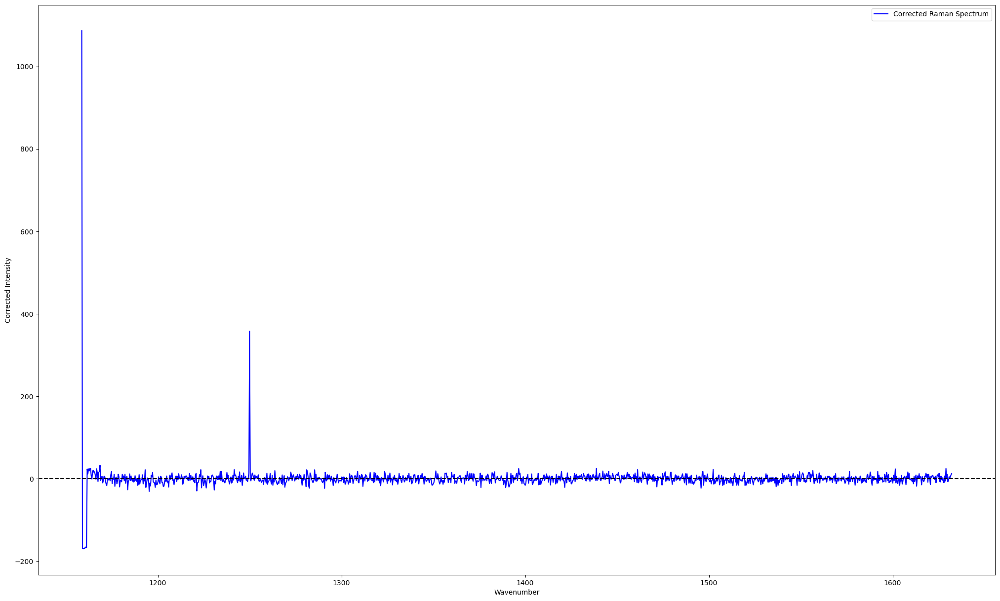

In [ ]:
from sklearn.preprocessing import PolynomialFeatures

poly = PolynomialFeatures(degree=3) 
X_poly = poly.fit_transform(df_subset['Wavenumber'].values.reshape(-1, 1))

from sklearn.linear_model import LinearRegression
model = LinearRegression()
model.fit(X_poly, df_subset['Intensity'])
baseline = model.predict(X_poly)

df_subset['Corrected_Intensity'] = df_subset['Intensity'] - baseline

plt.figure(figsize=(25, 15))
plt.plot(df_subset['Wavenumber'], df_subset['Corrected_Intensity'], color='blue', label='Corrected Raman Spectrum')
plt.axhline(0, color='black', linestyle='--')
plt.xlabel('Wavenumber')
plt.ylabel('Corrected Intensity')
plt.legend()
plt.show()


In [ ]:
import math

data_points = 1340
num_frames = len(df) / data_points

if num_frames.is_integer():
    num_frames = int(num_frames) 
else:
    print("num_frames is not a whole number")

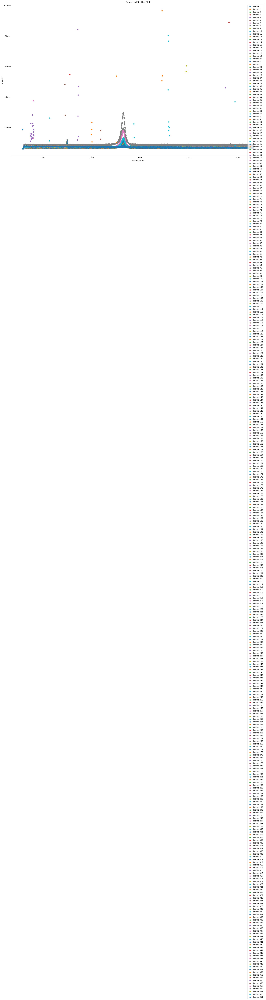

In [ ]:
plt.figure(figsize=(25, 15))

for i in range(num_frames):

    df_iter_subset1 = df.iloc[i * data_points:(i + 1) * data_points]
    
    plt.scatter(df_iter_subset1['Wavenumber'], df_iter_subset1['Intensity'], 
                label=f'Frame {i + 1}') 

plt.title('Combined Scatter Plot')
plt.xlabel('Wavenumber')
plt.ylabel('Intensity')

plt.legend(loc='upper right')

plt.show()

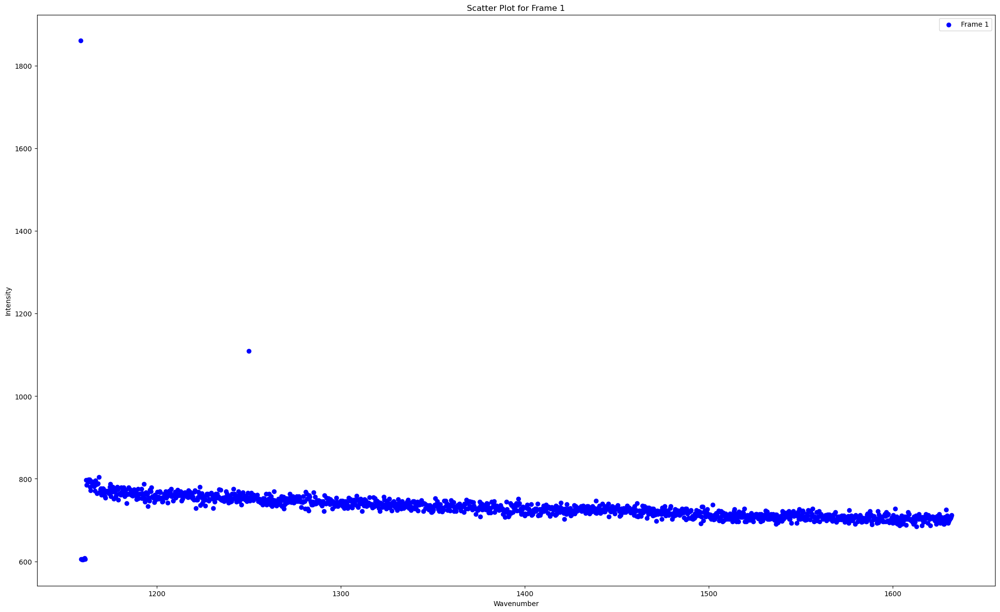

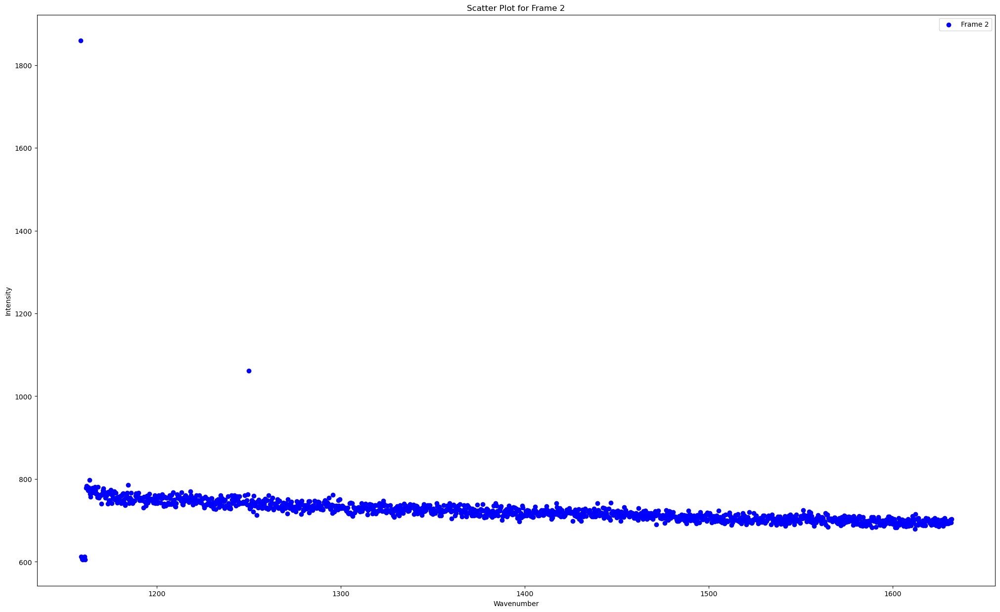

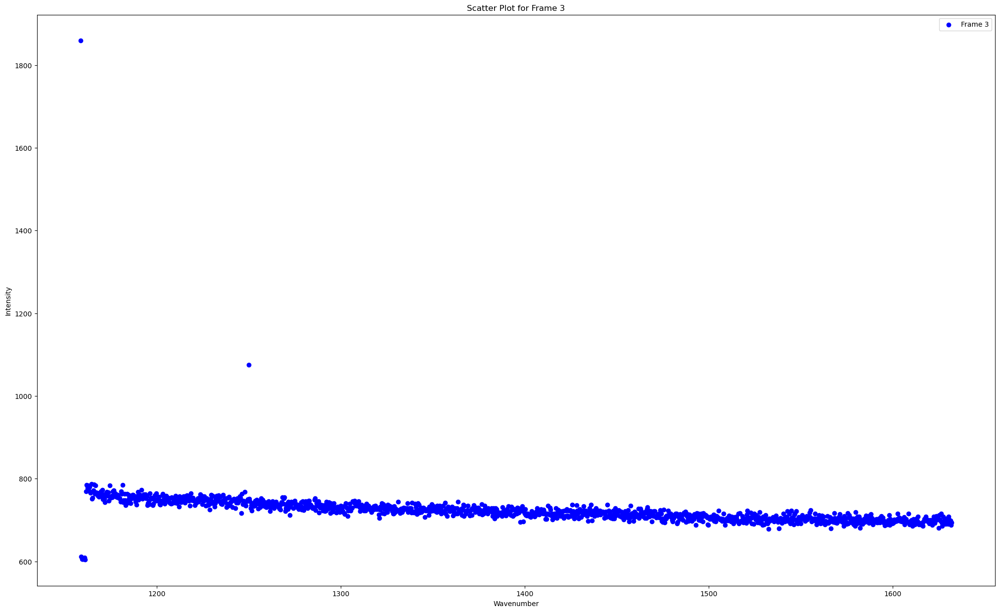

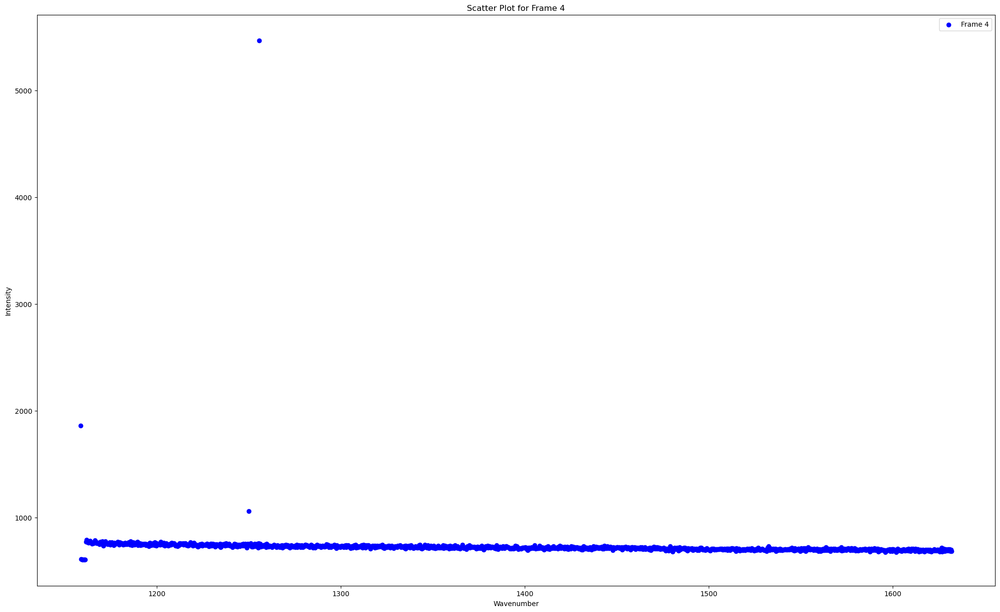

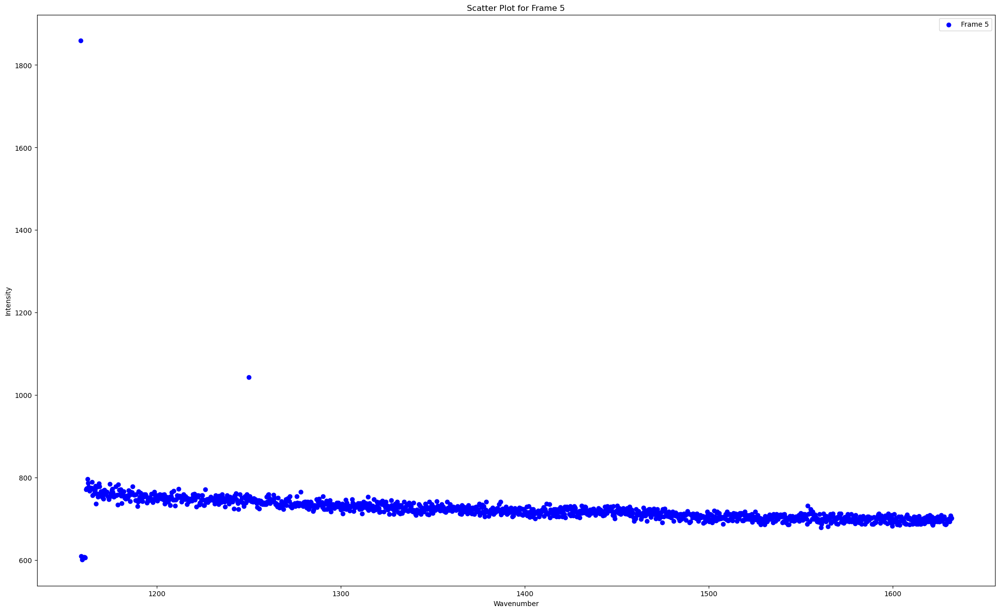

...

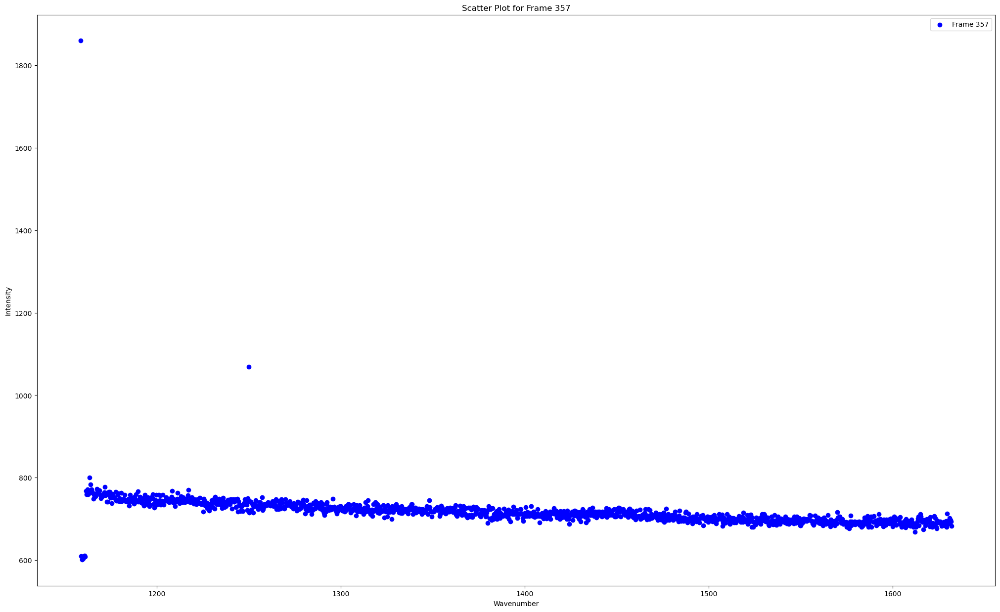

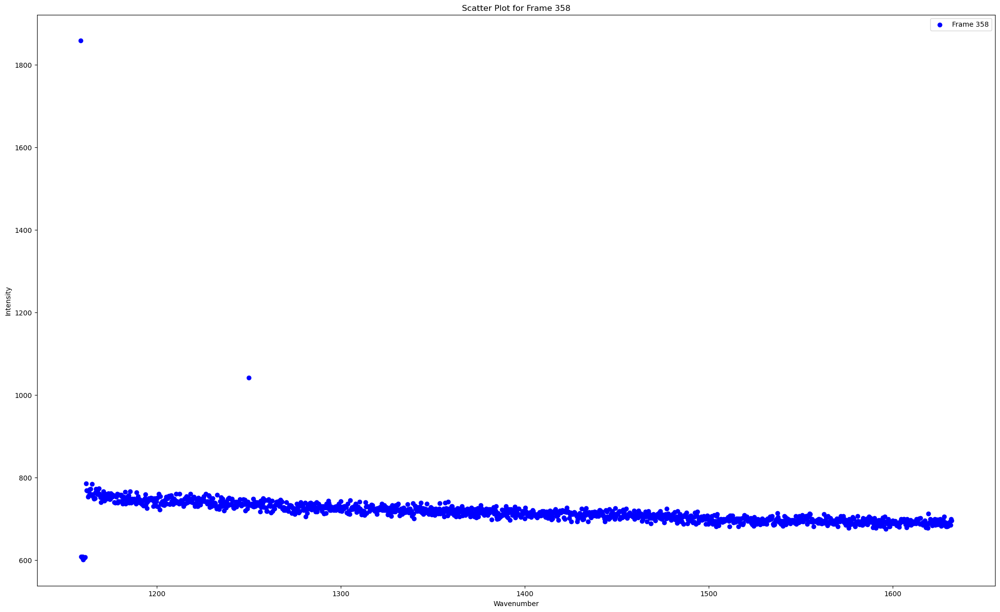

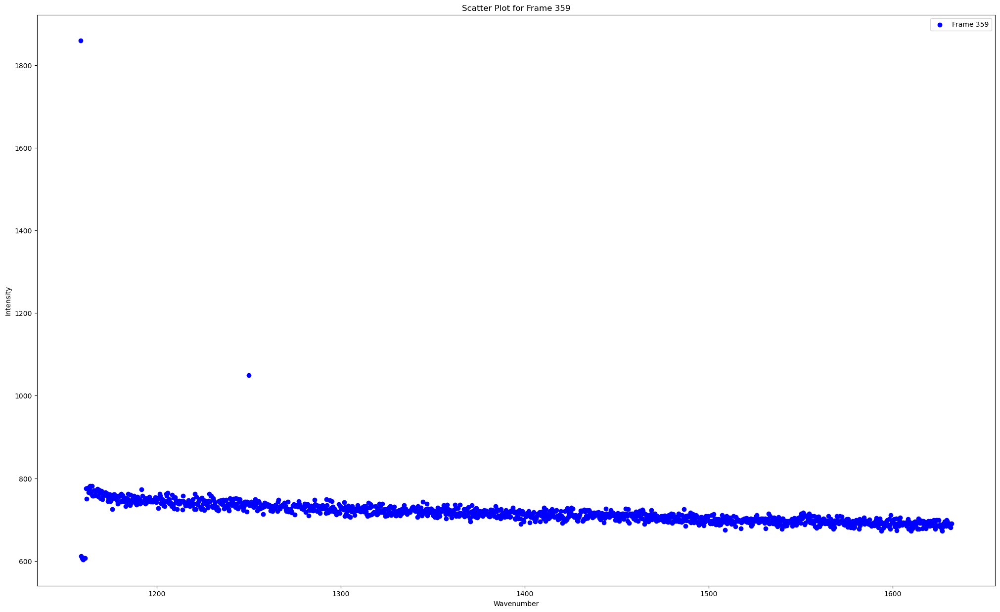

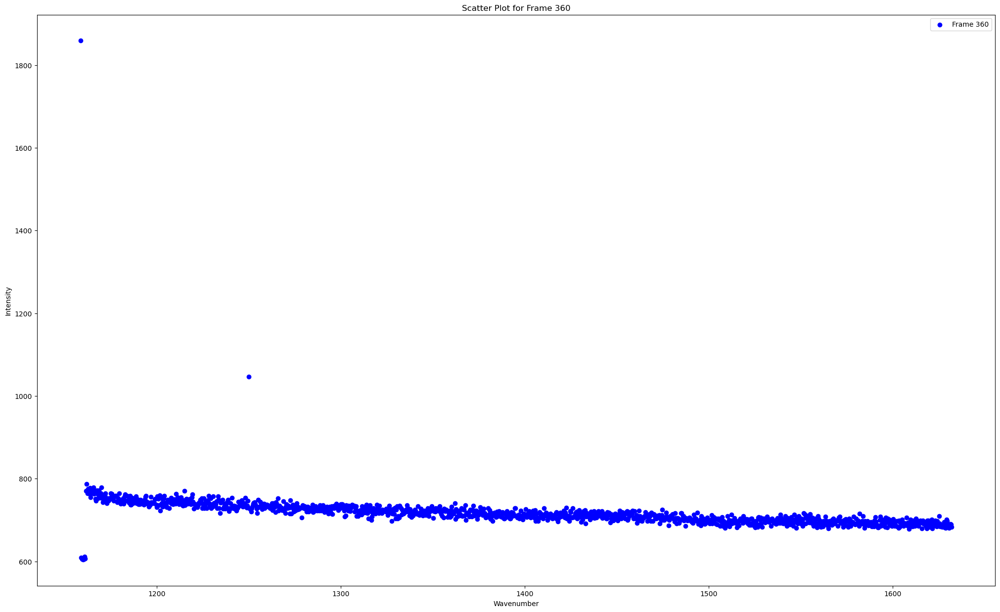

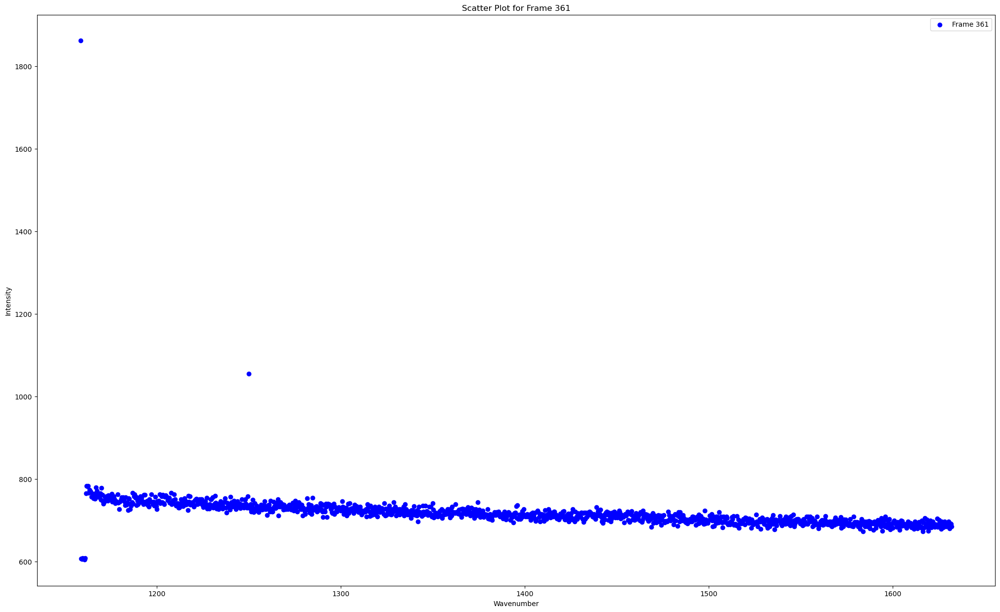

In [ ]:
for i in range(num_frames):

    df_iter_subset2 = df.iloc[i * data_points:(i + 1) * data_points]
    
    plt.figure(figsize=(25, 15))
    plt.scatter(df_iter_subset2['Wavenumber'], df_iter_subset2['Intensity'], color='blue', label=f'Frame {i + 1}')
    
    plt.title(f'Scatter Plot for Frame {i + 1}')
    plt.xlabel('Wavenumber')
    plt.ylabel('Intensity')
    
    plt.legend()
    
    plt.show()

In [17]:
#input_file = r'C:/Users/SPHERES/Downloads/hBN_map4_small.csv' #file path
#output_file = os.path.splitext(input_file)[0] + '_spectral_features.xlsx'

#sumary_df = process_csv(input_file)
#show_summary_popup(summary_df)

#save_to_excel(summary_df, output_file)